importing packages

In [ ]:

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation


defining and assigning values to constants

In [2]:

m=1
hbar=1
Nx=1000
Nt=1000
a=0
b=1000
dx=(b-a)/(Nx-1)
dp=(2*np.pi*hbar)/Nx*dx
dt=0.5

Defining the grid

In [3]:
#Here we will work in two spaces, @position and @momentum,hence we will have two grids

#preparing the position grid
x=a+np.arange(a,b,1)*dx
print('x=',x)
#preparing the momentum grid
p=np.concatenate((np.arange(0,(Nx/2)),np.arange(-Nx/2,0)))*dp
print('p=',p)


x= [   0.            1.001001      2.002002      3.003003      4.004004
    5.00500501    6.00600601    7.00700701    8.00800801    9.00900901
   10.01001001   11.01101101   12.01201201   13.01301301   14.01401401
   15.01501502   16.01601602   17.01701702   18.01801802   19.01901902
   20.02002002   21.02102102   22.02202202   23.02302302   24.02402402
   25.02502503   26.02602603   27.02702703   28.02802803   29.02902903
   30.03003003   31.03103103   32.03203203   33.03303303   34.03403403
   35.03503504   36.03603604   37.03703704   38.03803804   39.03903904
   40.04004004   41.04104104   42.04204204   43.04304304   44.04404404
   45.04504505   46.04604605   47.04704705   48.04804805   49.04904905
   50.05005005   51.05105105   52.05205205   53.05305305   54.05405405
   55.05505506   56.05605606   57.05705706   58.05805806   59.05905906
   60.06006006   61.06106106   62.06206206   63.06306306   64.06406406
   65.06506507   66.06606607   67.06706707   68.06806807   69.06906907
   70

Initialise the wave packet

In [4]:
##assining values to different constants present in our initial wavepacket
k0=m/2
x0=485
sigma=0.8

##wavepacket
psi=np.ones(len(x),dtype=complex)
psi*=1/(sigma*np.sqrt(2*np.pi))
psi*=np.exp(-0.5*((x-x0)/sigma)**2)
psi*=np.exp(1j*k0*x)


#print(psi)

plotting initial wavepacket

C:\Users\rajya\OneDrive\Documents\Anaconda\lib\site-packages\matplotlib\cbook\__init__.py:1298: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


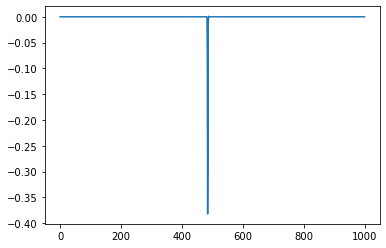

In [5]:
plt.plot(x,psi)
plt.savefig("Initial Wavepacket.png")

plotting the fourier transform of the wavepacket

C:\Users\rajya\OneDrive\Documents\Anaconda\lib\site-packages\matplotlib\cbook\__init__.py:1298: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


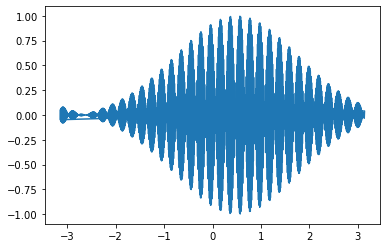

In [6]:
plt.plot(p,np.fft.fft(psi))
plt.savefig("Initial Wavepacket in P.png")

defining potential energy operator

In [15]:
##defining time dependent part
t_on=200
t_off=900
t_end=999
epsilon0=0.001
omega=0.005
def epsilon(t):
  if 0<=t<=t_on :
    epsilon=epsilon0*(np.sin(np.pi*t/2*t_on))**2
    epsilon*=np.cos(omega*t)
    return epsilon

  elif t_on<t<t_off:
    epsilon=epsilon0*np.cos(omega*t)
    return epsilon

  elif t_end>=t>=t_off:
    epsilon=epsilon0*(np.cos(np.pi*(t-t_off)/2*(t_end-t_off)))**2
    epsilon*=np.cos(omega*t)
    return epsilon


##complete potential
def v(x,t):
  v=0.00007*((x-500)**4)-0.024*((x-500)**2) + 0.1 #epsilon(t)*x

  return v


defining kinetic energy operator

In [16]:
k=p**2/2*m

plotting potential function

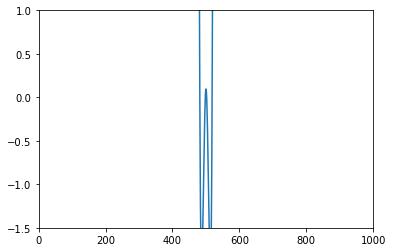

In [17]:
t=0
plt.xlim(0,1000)
plt.ylim(-1.5,1)
plt.plot(x,v(x,t))

working with split operator method

In [18]:
wfr=[]
for t in np.arange(0,1000,1):
 #exponential form of potential energy operator
 v_e=np.exp(-1j*dt*v(x,t)/2*hbar)

 #exponential form of kinetic energy operator
 k_e=np.exp(-1j*dt*k/hbar)

  #split operator method
 if t==0:
  psi=psi
 else:
  psi=v_e*psi
  psi_k=np.fft.fft(psi)
  psi_k=k_e*psi_k
  psi=np.fft.ifft(psi_k)
  psi=v_e*psi                    #updated wavefunction in real space
  psi_k=np.fft.fft(psi)          #updated wavefunction in momentum space
 wfr.append(psi)
wfr=np.array(wfr)
print(wfr)

[[-2.71727961e-06+6.94499329e-07j -1.63349112e-06+7.26168905e-07j
   1.65917213e-06-1.84512848e-06j ...  2.01277674e-07-2.50967805e-08j
   6.12361244e-07+1.77162867e-07j  1.48252418e-06+1.06040775e-06j]
 [-1.78294026e-06+2.53597883e-06j -3.05490315e-07+2.00625170e-06j
  -2.10584025e-06-1.31434087e-06j ...  1.00454591e-06-3.48997289e-07j
   8.12916233e-07-6.90210190e-07j  5.36654473e-07-6.99333792e-07j]
 [ 1.19614609e-08+3.48941670e-06j  1.61880149e-06-1.00342398e-07j
  -3.79782869e-07+1.38243564e-06j ...  8.40362601e-08-7.99843098e-07j
  -8.11507039e-07-7.43601646e-07j -1.06226327e-06-1.08977852e-06j]
 ...
 [-2.26657215e-06+2.97204419e-06j  3.27762316e-07-7.09299568e-07j
  -5.22397158e-07+3.14076001e-07j ... -2.88686724e-07-8.02074894e-07j
   9.08046144e-07+6.11642875e-07j  3.06659538e-07-1.27342087e-06j]
 [ 5.14276623e-07+2.46970433e-06j -1.24636828e-06+1.17107456e-06j
   1.16035481e-06+7.26131019e-07j ... -3.85319032e-07+2.13592253e-07j
   2.96607036e-07-2.02906778e-06j -1.81263223e-

plotting certain wavefunction associated with the defined potential

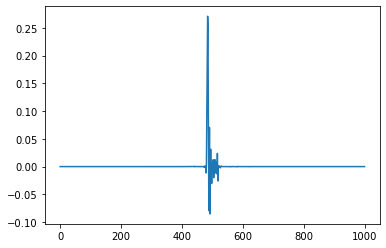

In [19]:
plt.plot(x,np.real(wfr[250]))

animating the wavefucntion density

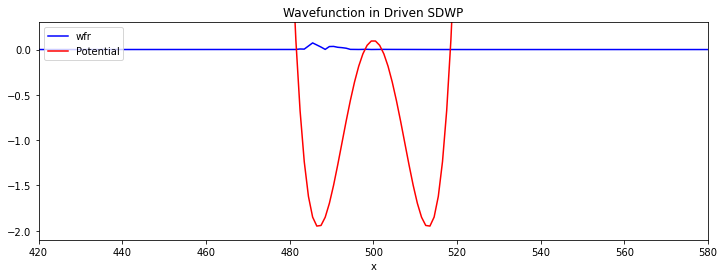

In [20]:
fig,ax =plt.subplots(figsize=(12,4))
ax.set(xlim=(420,580), ylim=(-2.1,0.3))
line1,=plt.plot([],[],'b-',label='wfr')
line2,=plt.plot([],[],'r-',label='Potential')

def animate(f):
  line1.set_data(x,np.real(np.conj(wfr[f])*wfr[f]))
  line2.set_data(x,v(x,f))
ax.set_xlabel('x')
ax.set_title('Wavefunction in Driven SDWP')
ax.legend(loc='upper left')
anim=FuncAnimation(fig, animate, frames=1000, interval=100)

plt.rcParams['animation.html']='jshtml'
anim

In [365]:
anim.save('wfr density (driven SDWP).mp4')

animating the wavefunction

In [ ]:
fig,ax =plt.subplots(figsize=(12,4))
ax.set(xlim=(420,580), ylim=(-2.1,0.8))
line1,=plt.plot([],[],'b-',label='wfr')
line2,=plt.plot([],[],'r-',label='Potential')

def animate(f):
    line1.set_data(x,np.real(wfr[f]))
    line2.set_data(x,v(x,f))
ax.set_xlabel('x')
ax.set_title('Wavefunction in Driven SDWP')
ax.legend(loc='upper left')
anim=FuncAnimation(fig, animate, frames=1000, interval=100)
#anim.save('wfr in driven SDWP1.mp4')

plt.rcParams['animation.html']='jshtml'
anim